# Case Study: Relative Mortality Prediction at County Level

Import Python packages

In [19]:
import pandas as pd
import io
import numpy as np
from numpy import asarray
from numpy import mean
from numpy import std
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import preprocessing
from sklearn import datasets, linear_model
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_validate
from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.tree import export_text
from sklearn.linear_model import ElasticNetCV
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedKFold
from urllib.request import urlopen
import json
import plotly.express as px

%matplotlib inline 
sns.set(color_codes=True)

## EDA and Data Processing

In [20]:
# Load data
mort_data = pd.read_csv('C:/dsge/form/mortality_data_clean.csv') #change the directory to the location of your data file
mort_data.head()

,State,Country,FIPS,MR_2014,LAND_AREA,URBANIZED_AREA_POP_CEN_2010,URBAN_CLUSTER_POP_CEN_2010,RURAL_POP_CEN_2010,Tot_Population_CEN_2010,Tot_Population_ACS_10_14,...,MLT_U2_9_STRC_ACS_10_14,MLT_U10p_ACS_10_14,Mobile_Homes_ACS_10_14,Crowd_Occp_U_ACS_10_14,Occp_U_NO_PH_SRVC_ACS_10_14,No_Plumb_ACS_10_14,Recent_Built_HU_ACS_10_14,Med_House_Value_BG_ACS_10_14,Med_House_Value_TR_ACS_10_14,Aggr_House_Value_ACS_10_14
0,United States,country,0,793.48,1.238973e+07,828558045,132411976,286946657,1247916678,1265926934,...,66861938,58485662,37590523,12363795,11735748,12897461,5460393,NaN,NaN,6.680000e+13
1,Alabama,state,1,995.59,2.773386e+05,21215389,4017223,9422029,34654641,35127005,...,1743458,1495905,1254504,304005,338427,397305,160720,NaN,NaN,1.620000e+12
2,Alabama,Autauga County,1001,989.16,5.944370e+02,31650,0,22921,54571,55136,...,1022,842,4401,530,463,817,679,120809.37500,126756.25000,2.229572e+09
3,Alabama,Baldwin County,1003,836.66,1.847631e+03,63649,71210,93126,227985,237059,...,10359,19912,16480,1317,2536,2103,1704,155773.77050,152304.83870,1.174932e+10
4,Alabama,Barbour County,1005,983.65,1.225933e+03,0,11544,32502,44046,43842,...,1517,363,4585,207,451,1009,216,92876.92308,91794.87179,1.558246e+09


In [21]:
# Check nonnumerical data fields
mort_data.describe(include=['object', 'bool'])

,State,Country
count,3194,3194
unique,52,1879
top,Texas,state
freq,255,51


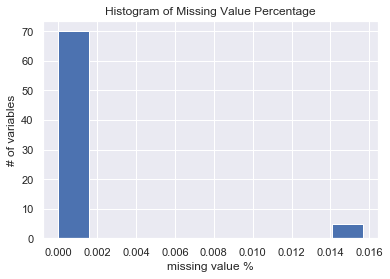

In [22]:
# Check % of missing data for each data field
missing_data_perc = mort_data.isna().sum()/(len(mort_data))
missing_data_perc[missing_data_perc>0]
fig = plt.figure()
plt.hist(missing_data_perc, bins = 10)
plt.title("Histogram of Missing Value Percentage")
plt.xlabel("missing value %")
plt.ylabel("# of variables")
plt.show()

In [23]:
#Remove data records at county level with NaN and validate that no missing data after the removal
mask = ((mort_data['Country'] == 'country') | (mort_data['Country'] == 'state'))
mort_data_state_country = mort_data.loc[mask]

mask = ((mort_data['Country'] != 'country') & (mort_data['Country'] != 'state'))
mort_data_county = mort_data.loc[mask]
mort_data_county = mort_data_county.dropna()

missing_data_perc = mort_data_county.isna().sum()/(len(mort_data_county))
print("Data fields with missing data:",missing_data_perc[missing_data_perc>0])

Data fields with missing data: Series([], dtype: float64)


In [24]:
#Data Processing

#data fields that need to be averaged
avg_cols = ['PUB_ASST_INC_ACS_10_14', 'Med_HHD_Inc_BG_ACS_10_14', 'Med_HHD_Inc_TR_ACS_10_14', 'Med_House_Value_BG_ACS_10_14', 'Med_House_Value_TR_ACS_10_14']

#data fields that are fixed
fixed_cols = ['State', 'Country', 'FIPS', 'MR_2014']

#list to store data fields that need to be summed
sum_cols = []
for name in mort_data_county.columns:
  if (name not in avg_cols) and (name not in fixed_cols):
    sum_cols.append(name)

# replace state level and country level data using average or sum of county level data
for row_idx in range(mort_data_state_country.shape[0]):
  country = mort_data_state_country.iloc[row_idx, mort_data_state_country.columns.get_loc('Country')]
  state = mort_data_state_country.iloc[row_idx]['State']
  if country == 'state':
    mort_data_county_mini = mort_data_county.loc[(mort_data_county['State']==state)]
    for name in sum_cols:
      mort_data_state_country.iloc[row_idx, mort_data_state_country.columns.get_loc(name)] = sum(mort_data_county_mini[name])
    for name in avg_cols:
      mort_data_state_country.iloc[row_idx, mort_data_state_country.columns.get_loc(name)] = mort_data_county_mini[name].mean()
    
for row_idx in range(mort_data_state_country.shape[0]):
  country = mort_data_state_country.iloc[row_idx, mort_data_state_country.columns.get_loc('Country')]
  if country != 'state':
    mort_data_state = mort_data_state_country.loc[(mort_data_state_country['Country']=='state')]
    for name in sum_cols:
      mort_data_state_country.iloc[row_idx, mort_data_state_country.columns.get_loc(name)] = sum(mort_data_state[name])
    for name in avg_cols:
      mort_data_state_country.iloc[row_idx, mort_data_state_country.columns.get_loc(name)] = mort_data_state[name].mean()

C:\Users\kshang\AppData\Roaming\Python\Python37\site-packages\pandas\core\indexing.py:966: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [25]:
# Drop any duplicated records
mort_data_state_country = mort_data_state_country.drop_duplicates()
print("Shape of state and country data:", mort_data_state_country.shape)
mort_data_county = mort_data_county.drop_duplicates()
print("Shape of county data:", mort_data_county.shape)

Shape of state and country data: (52, 75)
Shape of county data: (3109, 75)


In [26]:
#Feature engineering: create new features
mort_data_county['land_per_capita'] = mort_data_county['LAND_AREA']/mort_data_county['Tot_Population_CEN_2010']
mort_data_county['urbanized_pop_pct'] = mort_data_county['URBANIZED_AREA_POP_CEN_2010']/mort_data_county['Tot_Population_CEN_2010']
mort_data_county['urban_cluster_pct'] = mort_data_county['URBAN_CLUSTER_POP_CEN_2010']/mort_data_county['Tot_Population_CEN_2010']
mort_data_county['rural_pop_pct'] = mort_data_county['RURAL_POP_CEN_2010']/mort_data_county['Tot_Population_CEN_2010']
mort_data_county['male_pct'] = mort_data_county['Males_CEN_2010']/mort_data_county['Tot_Population_CEN_2010']
mort_data_county['female_pct'] = mort_data_county['Females_CEN_2010']/mort_data_county['Tot_Population_CEN_2010']
mort_data_county['age_5_pct'] = mort_data_county['Pop_under_5_CEN_2010']/mort_data_county['Tot_Population_CEN_2010']
mort_data_county['age_5_17_pct'] = mort_data_county['Pop_5_17_CEN_2010']/mort_data_county['Tot_Population_CEN_2010']
mort_data_county['age_18_24_pct'] = mort_data_county['Pop_18_24_CEN_2010']/mort_data_county['Tot_Population_CEN_2010']
mort_data_county['age_25_44_pct'] = mort_data_county['Pop_25_44_CEN_2010']/mort_data_county['Tot_Population_CEN_2010']
mort_data_county['age_45_64_pct'] = mort_data_county['Pop_45_64_CEN_2010']/mort_data_county['Tot_Population_CEN_2010']
mort_data_county['age_65_pct'] = mort_data_county['Pop_65plus_CEN_2010']/mort_data_county['Tot_Population_CEN_2010']
mort_data_county['hispanic_pct'] = mort_data_county['Hispanic_CEN_2010']/mort_data_county['Tot_Population_CEN_2010']
mort_data_county['white_pct'] = mort_data_county['NH_White_alone_CEN_2010']/mort_data_county['Tot_Population_CEN_2010']
mort_data_county['black_pct'] = mort_data_county['NH_Blk_alone_CEN_2010']/mort_data_county['Tot_Population_CEN_2010']
mort_data_county['aian_pct'] = mort_data_county['NH_AIAN_alone_CEN_2010']/mort_data_county['Tot_Population_CEN_2010']
mort_data_county['asian_pct'] = mort_data_county['NH_Asian_alone_CEN_2010']/mort_data_county['Tot_Population_CEN_2010']
mort_data_county['nhopi_pct'] = mort_data_county['NH_NHOPI_alone_CEN_2010']/mort_data_county['Tot_Population_CEN_2010']
mort_data_county['sor_pct'] = mort_data_county['NH_SOR_alone_CEN_2010']/mort_data_county['Tot_Population_CEN_2010']
mort_data_county['not_hs_pct'] = mort_data_county['Not_HS_Grad_ACS_10_14']/mort_data_county['Tot_Population_ACS_10_14']
mort_data_county['college_pct'] = mort_data_county['College_ACS_10_14']/mort_data_county['Tot_Population_ACS_10_14']
mort_data_county['poverty_pct'] = mort_data_county['Prs_Blw_Pov_Lev_ACS_10_14']/mort_data_county['Tot_Population_ACS_10_14']
mort_data_county['one_health_ins_pct'] = mort_data_county['One_Health_Ins_ACS_10_14']/mort_data_county['Tot_Population_ACS_10_14']
mort_data_county['two_plus_health_ins_pct'] = mort_data_county['Two_Plus_Health_Ins_ACS_10_14']/mort_data_county['Tot_Population_ACS_10_14']
mort_data_county['no_health_ins_pct'] = mort_data_county['No_Health_Ins_ACS_10_14']/mort_data_county['Tot_Population_ACS_10_14']
mort_data_county['med_hh_inc'] = mort_data_county['Med_HHD_Inc_BG_ACS_10_14']
mort_data_county['avg_hh_inc'] = mort_data_county['Aggregate_HH_INC_ACS_10_14']/mort_data_county['Tot_Occp_Units_ACS_10_14']
mort_data_county['med_house_value'] = mort_data_county['Med_House_Value_BG_ACS_10_14']
mort_data_county['avg_house_value'] = mort_data_county['Aggr_House_Value_ACS_10_14']/mort_data_county['Tot_Occp_Units_ACS_10_14']

#List of all explantory variables to be used for predictive modeling
x_cols=['land_per_capita',
        'urbanized_pop_pct',
        'urban_cluster_pct',
        'rural_pop_pct',
        'male_pct',
        'female_pct',
        'age_5_pct',
        'age_5_17_pct',
        'age_18_24_pct',
        'age_25_44_pct',
        'age_45_64_pct',
        'age_65_pct',
        'hispanic_pct',
        'white_pct',
        'black_pct',
        'aian_pct',
        'asian_pct',
        'nhopi_pct',
        'sor_pct',
        'not_hs_pct',
        'college_pct',
        'poverty_pct',
        'one_health_ins_pct',
        'two_plus_health_ins_pct',
        'no_health_ins_pct',
        'med_hh_inc',
        'avg_hh_inc',
        'med_house_value',
        'avg_house_value']

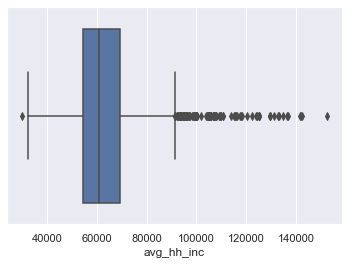

In [27]:
#Sample boxplot of a single data field
sns.boxplot(x=(mort_data_county['avg_hh_inc']))

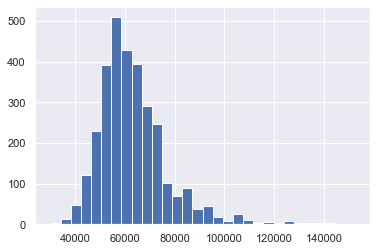

In [28]:
#Sample histogram of a single data field
x = mort_data_county['avg_hh_inc']
# print(x.shape)
plt.hist(x,bins=30)#, range=[0, 3])
plt.show()

In [29]:
#Create response varaible for relative mortality
mort_data_county['MR_Relative'] = mort_data_county['MR_2014']/mort_data_state_country.iloc[0, mort_data_state_country.columns.get_loc('MR_2014')]
mort_data_state_country['MR_Relative'] = mort_data_state_country['MR_2014']/mort_data_state_country.iloc[0, mort_data_state_country.columns.get_loc('MR_2014')]

In [30]:
#create State average relative mortality as an additional variable in the county level data.
mort_data_county['state_avg'] = 1
for i in range(mort_data_state_country.shape[0]):
    state = mort_data_state_country.iloc[i, mort_data_state_country.columns.get_loc('State')]
    mort_data_county.loc[mort_data_county['State']==state,'state_avg'] = mort_data_state_country.iloc[i, mort_data_state_country.columns.get_loc('MR_Relative')]
# print(mort_data_county['state_avg'])

In [31]:
# Map of the county level relative moratlity
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

mort_data_county['FIPS'] = mort_data_county['FIPS'].apply(str)
mort_data_county['FIPS'] = mort_data_county['FIPS'].apply(lambda x: x.zfill(5))

fig = px.choropleth(mort_data_county, geojson=counties, locations='FIPS', color='MR_Relative',
                           color_continuous_scale="Aggrnyl",#"Viridis",
                           range_color=(0.3, 2.2),
                           scope="usa",
                           labels={'MR_Relative':'relative mortality'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [32]:
#Data normalization
x_cols_scale = ['land_per_capita',
        'med_hh_inc',
        'avg_hh_inc',
        'med_house_value',
        'avg_house_value']
scaler = preprocessing.StandardScaler()#MinMaxScaler()
mort_data_county[x_cols] = scaler.fit_transform(mort_data_county[x_cols])
#print(scaler.mean_,scaler.scale_)
# print(mort_data_county[x_cols].mean(axis=0),mort_data_county[x_cols].std(axis=0))

0.8616144086223777


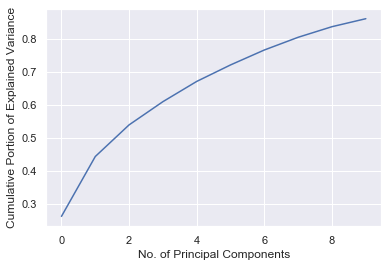

In [33]:
#Principal component analysis
pca = PCA(n_components=10)
pca.fit(mort_data_county[x_cols])
pd.DataFrame(pca.components_).to_csv('mort_pc_components.csv')
#print(pca.components_, pca.explained_variance_)
X_pca = pca.transform(mort_data_county[x_cols])
print(sum(pca.explained_variance_ratio_[0:10]))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('No. of Principal Components')
plt.ylabel('Cumulative Portion of Explained Variance');

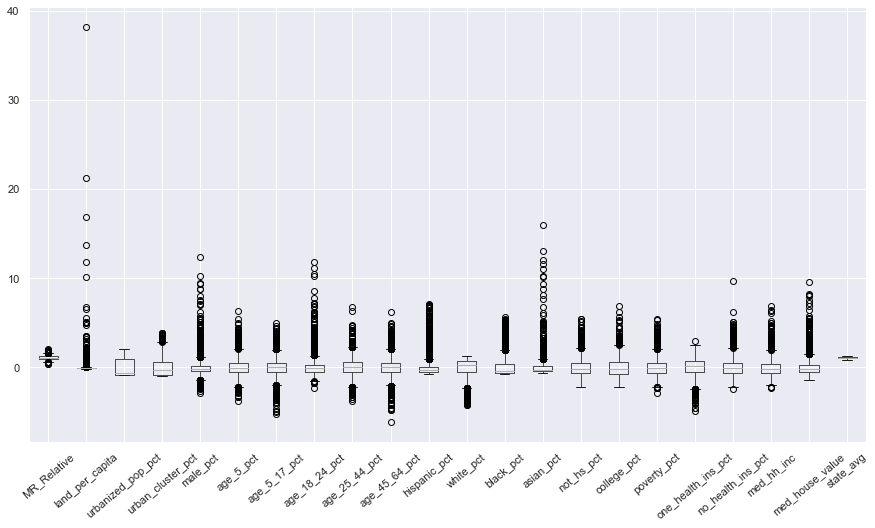

In [34]:
#Sample boxplot of multiple data fields
c_cols = ['MR_Relative',
        'land_per_capita',
        'urbanized_pop_pct',
        'urban_cluster_pct',
        'male_pct',
        'age_5_pct',
        'age_5_17_pct',
        'age_18_24_pct',
        'age_25_44_pct',
        'age_45_64_pct',
        'hispanic_pct',
        'white_pct',
        'black_pct',
        'asian_pct',
        'not_hs_pct',
        'college_pct',
        'poverty_pct',
        'one_health_ins_pct',
        'no_health_ins_pct',
        'med_hh_inc',
        'med_house_value',
          'state_avg'
         ]

c = mort_data_county[c_cols]
c.boxplot(figsize=(15,8),rot=40)

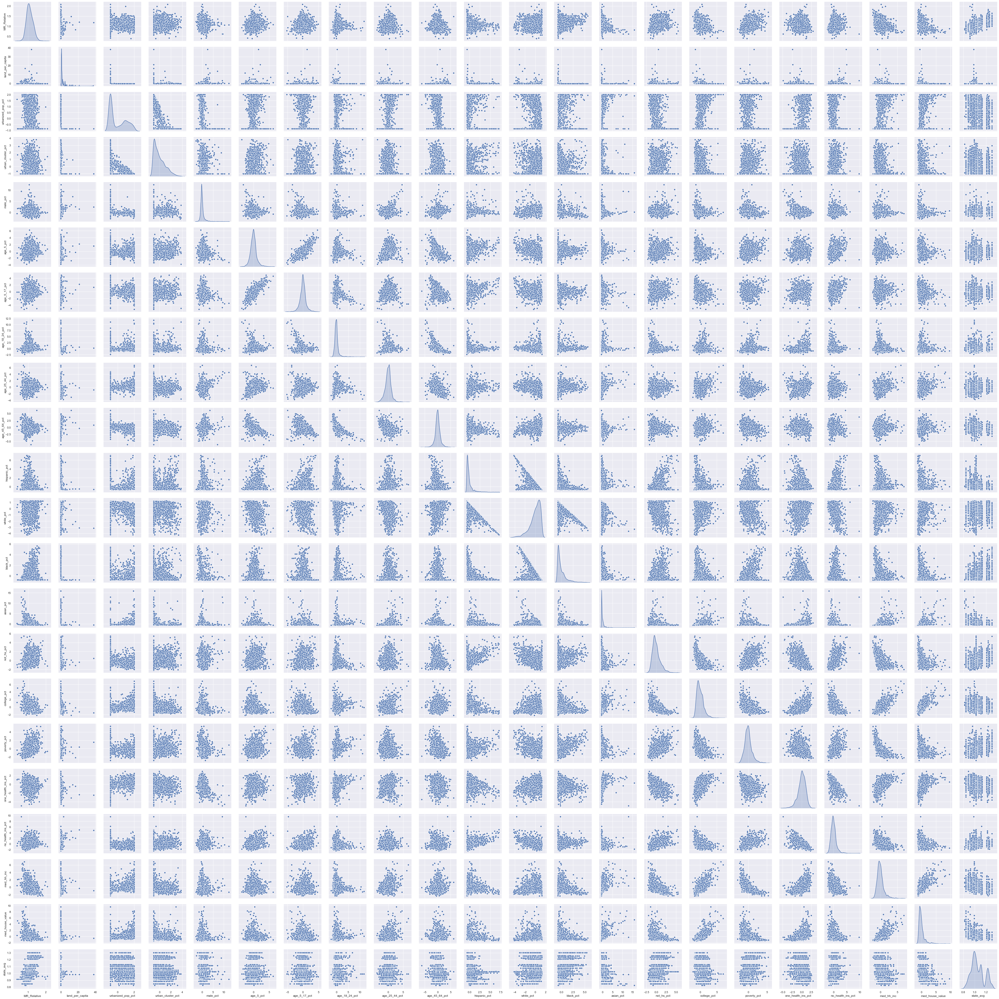

In [35]:
#Sample pair plot
sns.pairplot(c, diag_kind="kde")

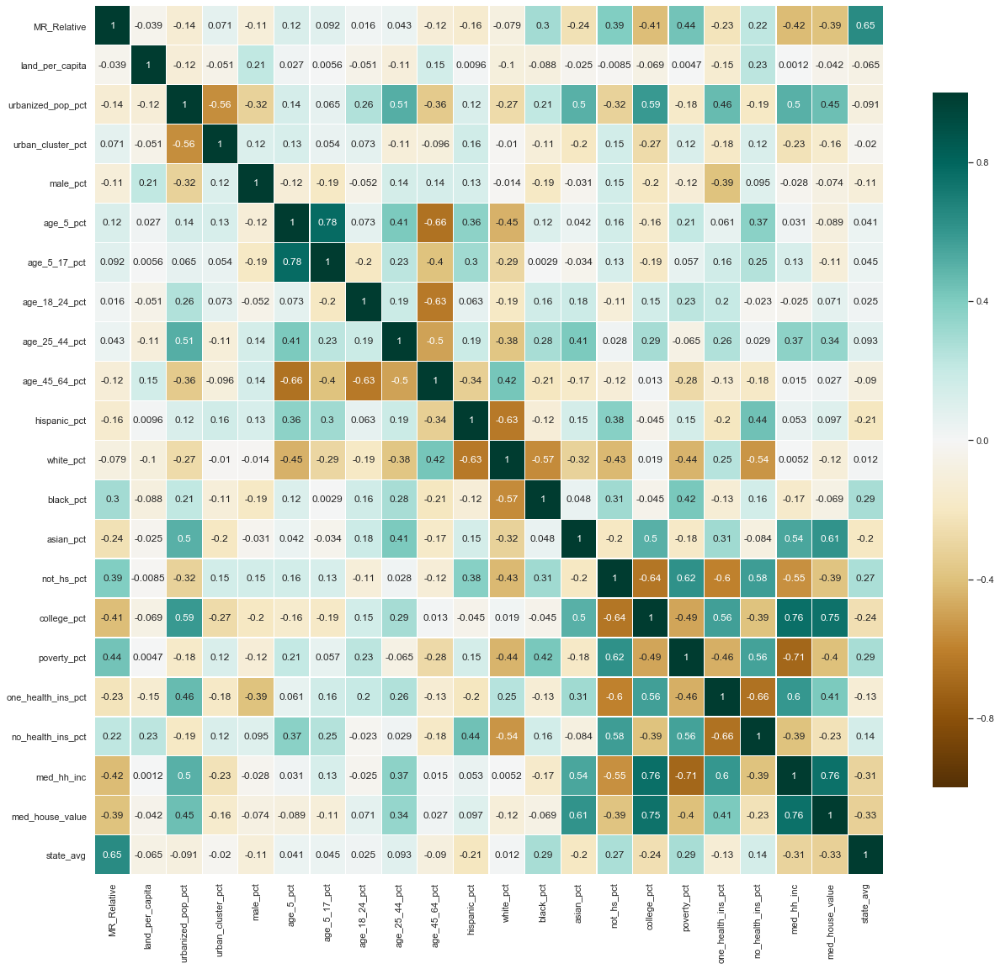

In [36]:
#Sample heatmap
d = c.corr()

fig, ax = plt.subplots(figsize=(21, 19))
sns.heatmap(d, vmin=-1, vmax=1, annot=True, cmap='BrBG',
           linewidth=0.3, cbar_kws={"shrink": .8})
plt.show()

## Model Training and Validation

In [37]:
#training and validation data split
train, test = train_test_split(mort_data_county, test_size=0.1, random_state=123)

Coefficients: [-3.34151386e-04  3.38045438e-02  2.38561712e-02 -1.87204554e-02
  6.82871383e-03 -1.92400552e-03  4.15853614e-03  1.71651701e-02
  1.41674649e-02 -4.81445488e-02 -2.93024555e-02 -2.40669182e-02
 -1.52840983e-02  2.70948214e-02 -4.13276469e-02  3.40675827e-02
 -1.55259128e-02 -1.47922971e-02  2.21956413e-02 -1.02386649e-02
  8.06558911e-01]
Intercept: 0.2506835511834866
RMSE: 0.12
Variance score: 0.518623


0.5528282783118268

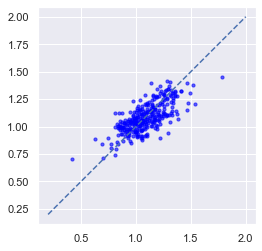

In [38]:
#Linear Regression

x_short_cols = c_cols[1:]#x_cols
regr = LinearRegression().fit(train[x_short_cols], train['MR_Relative'])

# Make predictions using the testing set
y_pred = regr.predict(test[x_short_cols])

# The coefficients
print('Coefficients:', regr.coef_)
print('Intercept:', regr.intercept_)
# The mean squared error
print("RMSE: %.2f"
      % mean_squared_error(test['MR_Relative'], y_pred)**0.5)
# Explained variance score: 1 is perfect prediction
print('Variance score: %.6f' % r2_score(test['MR_Relative'], y_pred))

x = np.linspace(0.2,2)
y = x
plt.plot(x, y, '--')
plt.scatter(test['MR_Relative'], y_pred, c='blue', s=10, alpha=0.6)
plt.ylim([0.2, 2])
plt.xlim([0.2, 2])
plt.axis('scaled')

regr.score(train[x_short_cols], train['MR_Relative'])

Feature importance: [0.00236885 0.         0.00415901 0.00668073 0.00989338 0.00631062
 0.00455837 0.00740617 0.0135934  0.01705056 0.00072224 0.00162446
 0.00455167 0.01721934 0.07088034 0.05880943 0.00480611 0.00766573
 0.02239766 0.01901809 0.72028383]
RMSE: 0.12
Variance score: 0.535122


(0.11, 2.09, 0.11, 2.09)

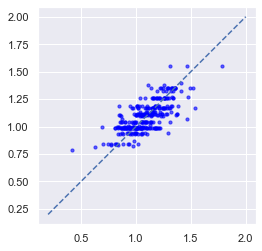

In [39]:
# CART
cart = DecisionTreeRegressor(max_depth=6,min_samples_split=2)

# Train the model using the training sets
cart.fit(train[x_short_cols], train['MR_Relative'])

# Make predictions using the testing set
y_pred = cart.predict(test[x_short_cols])

# The coefficients
print('Feature importance:', cart.feature_importances_)
# The mean squared error
print("RMSE: %.2f"
      % mean_squared_error(test['MR_Relative'], y_pred)**0.5)
# Explained variance score: 1 is perfect prediction
print('Variance score: %.6f' % r2_score(test['MR_Relative'], y_pred))

tree_rules = export_text(cart, feature_names=list(x_short_cols))
# print(tree_rules)

x = np.linspace(0.2,2)
y = x
plt.plot(x, y, '--')
plt.scatter(test['MR_Relative'], y_pred, c='blue', s=10, alpha=0.6)
plt.ylim([0.2, 2])
plt.xlim([0.2, 2])
plt.axis('scaled')


Feature importance: [0.01068503 0.00155482 0.00719911 0.00788966 0.00988236 0.01384496
 0.00835434 0.00989195 0.00995266 0.010918   0.00740051 0.01194561
 0.00556884 0.02760362 0.04843286 0.05099676 0.00488028 0.0056152
 0.0343634  0.03220234 0.68081769]
RMSE: 0.11
Variance score: 0.554624


(0.11, 2.09, 0.11, 2.09)

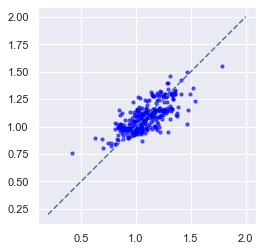

In [40]:
# Random Forest
rf = RandomForestRegressor(max_depth=6, random_state=123,n_estimators=500,max_features="auto")#"sqrt")

# Train the model using the training sets
rf.fit(train[x_short_cols], train['MR_Relative'].values.ravel())

# Make predictions using the testing set
y_pred = rf.predict(test[x_short_cols])

# The coefficients
print('Feature importance:', rf.feature_importances_)
# The mean squared error
print("RMSE: %.2f"
      % mean_squared_error(test['MR_Relative'], y_pred)**0.5)
# Explained variance score: 1 is perfect prediction
print('Variance score: %.6f' % r2_score(test['MR_Relative'], y_pred))

x = np.linspace(0.2,2)
y = x
plt.plot(x, y, '--')
plt.scatter(test['MR_Relative'], y_pred, c='blue', s=10, alpha=0.6)
plt.ylim([0.2, 2])
plt.xlim([0.2, 2])
plt.axis('scaled')


Feature importance: [0.02361274 0.00669726 0.01160513 0.01589889 0.01565262 0.01653123
 0.02299785 0.02338549 0.01826569 0.02953975 0.01589434 0.03002003
 0.01543393 0.05425766 0.05721398 0.07387287 0.01789925 0.03098956
 0.06677623 0.06371106 0.38974445]
RMSE: 0.11
Variance score: 0.583103


(0.11, 2.09, 0.11, 2.09)

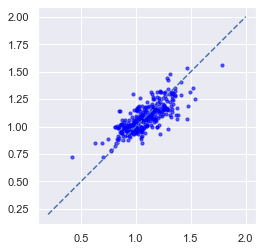

In [41]:
#GBM
gbm = GradientBoostingRegressor(loss='ls', n_estimators=1000, max_depth=6, random_state = 123,
                                learning_rate=.005, min_samples_leaf=3, min_samples_split=6,max_features="sqrt",tol=1e-6)#"sqrt")

# Train the model using the training sets
gbm.fit(train[x_short_cols], train['MR_Relative'].values.ravel())

# Make predictions using the testing set
y_pred = gbm.predict(test[x_short_cols])

# The coefficients
print('Feature importance:', gbm.feature_importances_)
# The mean squared error
print("RMSE: %.2f"
      % mean_squared_error(test['MR_Relative'], y_pred)**0.5)
# Explained variance score: 1 is perfect prediction
print('Variance score: %.6f' % r2_score(test['MR_Relative'], y_pred))

x = np.linspace(0.2,2)
y = x
plt.plot(x, y, '--')
plt.scatter(test['MR_Relative'], y_pred, c='blue', s=10, alpha=0.6)
plt.ylim([0.2, 2])
plt.xlim([0.2, 2])
plt.axis('scaled')


RMSE: 0.12
Variance score: 0.533712


(0.11, 2.09, 0.11, 2.09)

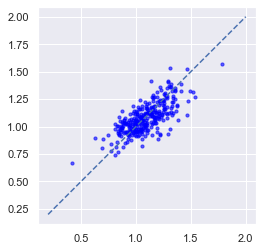

In [42]:
#ANN
ann = MLPRegressor(hidden_layer_sizes=(5,20,20,5),max_iter=500000,alpha=0.001,batch_size=100,random_state=123,
                   learning_rate="adaptive",learning_rate_init=0.005, tol=1e-6, solver="adam")

# Train the model using the training sets
ann.fit(train[x_short_cols], train['MR_Relative'].values.ravel())

# Make predictions using the testing set
y_pred = ann.predict(test[x_short_cols])

# The coefficients
#print('Coefficients:', ann.coefs_)
#print('Feature importance:', ann.feature_importances_)
# The mean squared error
print("RMSE: %.2f"
      % mean_squared_error(test['MR_Relative'], y_pred)**0.5)
# Explained variance score: 1 is perfect prediction
print('Variance score: %.6f' % r2_score(test['MR_Relative'], y_pred))

x = np.linspace(0.2,2)
y = x
plt.plot(x, y, '--')
plt.scatter(test['MR_Relative'], y_pred, c='blue', s=10, alpha=0.6)
plt.ylim([0.2, 2])
plt.xlim([0.2, 2])
plt.axis('scaled')


alpha: 0.00016184643216457363
Coefficients: [-0.          0.03299284  0.02343198 -0.01813068  0.00559936 -0.00121619
  0.00322861  0.01697526  0.01246227 -0.04677162 -0.02642637 -0.02152849
 -0.01464659  0.0267791  -0.04073358  0.03384586 -0.01436229 -0.01334261
  0.0207967  -0.01001052  0.79078223]
Intercept: 0.2673467748265479
RMSE: 0.12
Variance score: 0.520130


(0.11, 2.09, 0.11, 2.09)

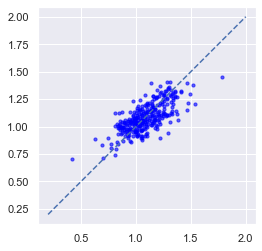

In [45]:
#ElasticNet
regr = ElasticNetCV(cv=5, random_state=0)
regr.fit(train[x_short_cols], train['MR_Relative'])

# Make predictions using the testing set
y_pred = regr.predict(test[x_short_cols])

# The coefficients
print('alpha:', regr.alpha_)
print('Coefficients:', regr.coef_)
print('Intercept:', regr.intercept_)
# The mean squared error
print("RMSE: %.2f"
      % mean_squared_error(test['MR_Relative'], y_pred)**0.5)
# Explained variance score: 1 is perfect prediction
print('Variance score: %.6f' % r2_score(test['MR_Relative'], y_pred))

x = np.linspace(0.2,2)
y = x
plt.plot(x, y, '--')
plt.scatter(test['MR_Relative'], y_pred, c='blue', s=10, alpha=0.6)
plt.ylim([0.2, 2])
plt.xlim([0.2, 2])
plt.axis('scaled')

RMSE: 0.14
Variance score: 0.303127


(0.11, 2.09, 0.11, 2.09)

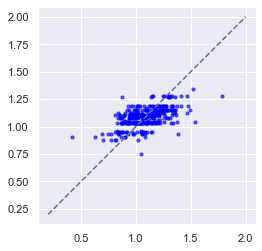

In [46]:
#K-means
kmeans = KMeans(n_clusters=30, random_state=0).fit(train[x_short_cols])
test_labels = kmeans.predict(test[x_short_cols])
y_pred = []
for l in test_labels:
    mask = kmeans.labels_ == l
    mort_relative_i = np.array(train['MR_Relative'])[mask]
    y_pred.append(np.mean(mort_relative_i))

# The mean squared error
print("RMSE: %.2f"
      % mean_squared_error(test['MR_Relative'], y_pred)**0.5)
# Explained variance score: 1 is perfect prediction
print('Variance score: %.6f' % r2_score(test['MR_Relative'], y_pred))

x = np.linspace(0.2,2)
y = x
plt.plot(x, y, '--')
plt.scatter(test['MR_Relative'], y_pred, c='blue', s=10, alpha=0.6)
plt.ylim([0.2, 2])
plt.xlim([0.2, 2])
plt.axis('scaled')